# Swisscom mini-project

This notebook presents similarities between locations in Switzerland. More precisely, we will classify using unsupervised methods the 100x100m tiles from Swisscom datasets, "Population Density Heatmap 27-Jan-2020".

In [1]:
# importation 
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import api_helpers as api
import geopandas as gpd
import keplergl
import helpers as hp

C:\Users\41789\anaconda3\envs\ox\lib\site-packages\pyproj\__init__.py:89: UserWarning: pyproj unable to set database path.
  _pyproj_global_context_initialize()


In [2]:
from sklearn.cluster import KMeans,DBSCAN
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import normalize
from tslearn.clustering import TimeSeriesKMeans , KShape
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

C:\Users\41789\anaconda3\envs\ox\lib\site-packages\tslearn\bases\bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


## 1. Collect all the data needed:

Those data are accessible through Swisscom API . So we had first to make an application to get a `client id` and a `client secret` on the Swisscom portal [1]. Note that all functions linked to the request are computed in the file `api_helpers.py` and all other details can be accessed from Swisscom documentation [2].

[1] https://digital.swisscom.com/products/heatmaps/info

[2] https://digital.swisscom.com/products/heatmaps/documentation/standard?v=2

## 2. Data import and cleaning

To reduce the amount of data treated, we will concentrate our analysis on 7 districts:
* District of Lausanne  (2225)
* District of Lausanne-West (2229)
* District of Zurich (112)
* District of Sion (2312)
* District of Locarno (2104)
* District of Luzern (311)
* District of Bern (246)

All district ids have been found on website of OFS ( office féféral de la statistique ). [3]

[3] https://www.bfs.admin.ch/bfs/fr/home/bases-statistiques/repertoire-officiel-communes-suisse.assetdetail.11467406.html


In [3]:
district_list=[2225,2229,112,2312,2104,311,246]

In [4]:
# request the tiles from district number
tiles_id_districts=[]
for request_id in district_list:
    tiles_id=api.get_tiles_from_districts(request_id)
    tiles_id_districts.append(tiles_id)   

------------------------------------------------------------------------

Once all tiles have been extracted, the score by hours by tile is requested from the API for a chosen date range ( Here it will be restricted to the 27.01.2021 due to the demo_plan )

In [5]:
date_range=pd.date_range(start='2020-01-27', end='2020-01-28', freq='1H')[:-1]

In [6]:
score_all=[]
for dist_num, tiles_id_df in zip(district_list,tiles_id_districts):
    print(dist_num)
    score=api.get_score_for_tiles(tiles_id_df,date_range,dist_num)
    score_all.append(score)

2225
Loading tile scores for district nbr 2225 from cached file
2229
Loading tile scores for district nbr 2229 from cached file
112
Loading tile scores for district nbr 112 from cached file
2312
Loading tile scores for district nbr 2312 from cached file
2104
Loading tile scores for district nbr 2104 from cached file
311
Loading tile scores for district nbr 311 from cached file
246
Loading tile scores for district nbr 246 from cached file


In [7]:
score_cleaned=pd.concat(score_all,axis=0).drop_duplicates()

In [8]:
score_cleaned.shape

(15674, 28)

In [9]:
score_cleaned["geometry"]=score_cleaned.apply(lambda x: hp.create_poly(x),axis=1)

All data have been imported, so we can visualize the heatmap on a map:

In [13]:
config_heatmap=np.load('Data/heatmap_config.npy',allow_pickle='TRUE').item()
score_cleaned_gpd = gpd.GeoDataFrame(score_cleaned, geometry=score_cleaned.geometry)
heatmap = keplergl.KeplerGl(height=400)
heatmap.add_data(data=score_cleaned_gpd,name="District Tiles")
heatmap.config = config_heatmap
heatmap

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'a64ql2', 'type': '…

In [12]:
# save configuration of the map to a pickle
np.save('Data/heatmap_config.npy',heatmap.config)

# 3. Analysis

### Analysis Plan:

* 3.1 First, we need to clean the data from unnecessary columns and visualize a sample of tiles, which have been normalized with the l2 norm.  

* 3.2 Secondly, we try to classify the tiles using Kmeans algorithms [4]. To determine the best k, an elbow method from the sum of squared distance (SSE) is observed

* 3.3 As we are dealing with time series, it may be better to not use euclidean distance to classify but rather a Dynamic time warping method instead. [5]

* 3.4 Thirdly, we will also compare Kmean results with an other clustering algorithms, Density-Based Spatial Clustering (DBSCAN)

* 3.5 Finally, one last clustering algorithms will be used : Kshape algorithm accessed on tslearn

* 3.5 Once, both methods have been computed. We will visualize the label and try to extract a meaningful explanation.
 
Note that for both methods we visualize all points in two dimensions using dimension reduction techniques (PCA and t-SNE) and we also visualize the k time-series cluster.
 

[4] https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html

[5] https://tslearn.readthedocs.io/en/stable/gen_modules/clustering/tslearn.clustering.TimeSeriesKMeans.html

## 3.1 Visualize some time series

In [15]:
# clean unnecessary columns
GEOLOCATION_COL=["ll_x","ll_y","ur_x","ur_y","geometry"]
time_series=score_cleaned.drop(GEOLOCATION_COL,axis=1)
time_series.head(1)

,2020-01-27 00:00:00,2020-01-27 01:00:00,2020-01-27 02:00:00,2020-01-27 03:00:00,2020-01-27 04:00:00,2020-01-27 05:00:00,2020-01-27 06:00:00,2020-01-27 07:00:00,2020-01-27 08:00:00,2020-01-27 09:00:00,...,2020-01-27 14:00:00,2020-01-27 15:00:00,2020-01-27 16:00:00,2020-01-27 17:00:00,2020-01-27 18:00:00,2020-01-27 19:00:00,2020-01-27 20:00:00,2020-01-27 21:00:00,2020-01-27 22:00:00,2020-01-27 23:00:00
tileId,,,,,,,,,,,,,,,,,,,,,
23610282,10.0,10.0,10.0,10.0,10.0,10.0,10.0,21.0,32.0,40.0,...,43.0,42.0,38.0,34.0,27.0,21.0,10.0,10.0,10.0,10.0


In [16]:
# take a sample of 20 tiles
np.random.seed(34)
tiles_sample=time_series.sample(20)
#normalize 
normalized_time_series=normalize(tiles_sample,norm="max",axis=1)

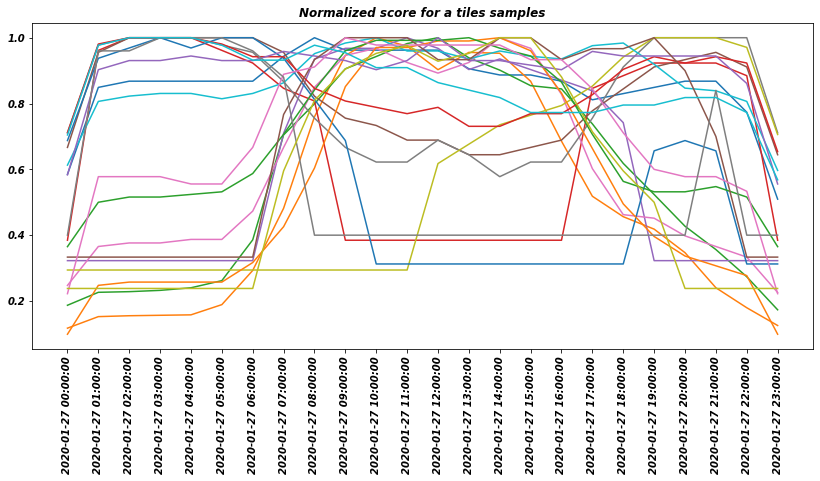

In [17]:
# visualisation 
plt.figure(figsize=(14,6))
plt.plot(normalized_time_series.T)
plt.title("Normalized score for a tiles samples",fontweight="bold")
plt.xticks(range(0,24),labels=tiles_sample.columns,rotation=90,fontweight="bold")
plt.yticks(fontweight="bold")
plt.show()

 In the figure above, we can distinguish some similar behavior between time series. Indeed, some are only active during the day while others are active during the night. Let's proceed to the clustering.

--------------------------------------------------------------------

## Dimension Reduction for visualisation

In [18]:
#normalize the whole dataset
ts_normalised=normalize(time_series,norm="max")

In [19]:
%%time
X_reduced_tsne = TSNE(n_components=2, random_state=0).fit_transform(ts_normalised) # transform en 2D
print("The features of the first sample are: %s" % X_reduced_tsne[0])

C:\Users\41789\anaconda3\envs\ox\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\41789\anaconda3\envs\ox\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


The features of the first sample are: [55.574757 31.665462]
CPU times: total: 21min 42s
Wall time: 4min 2s


In [20]:
%%time
X_reduced_pca = PCA(n_components=2).fit(ts_normalised).transform(ts_normalised)

print("The features of the first sample are: %s" % X_reduced_pca[0])

The features of the first sample are: [1.53989807 0.07929687]
CPU times: total: 406 ms
Wall time: 93.7 ms


--------------------------------------------------------------------------------------------------------------------------

## 3.2 Kmean Analysis with euclidean distances

https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html

### Elbow method

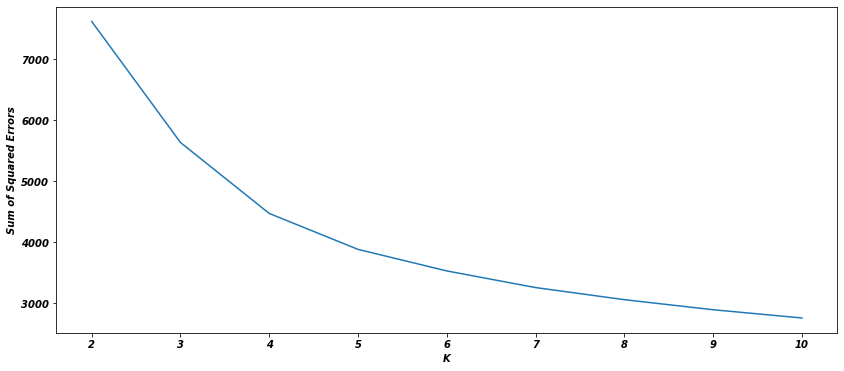

In [21]:
hp.plot_sse(ts_normalised)

Here we observe that the SSE decreases fast at first until k = 4,5. So, one of those two number of cluster will be a good trade-off. We will continue with k=4.


## Reducted dimension graph 


In [22]:
k=4
kmeans = KMeans(n_clusters=k, random_state=10).fit(ts_normalised)
labels_km=kmeans.labels_

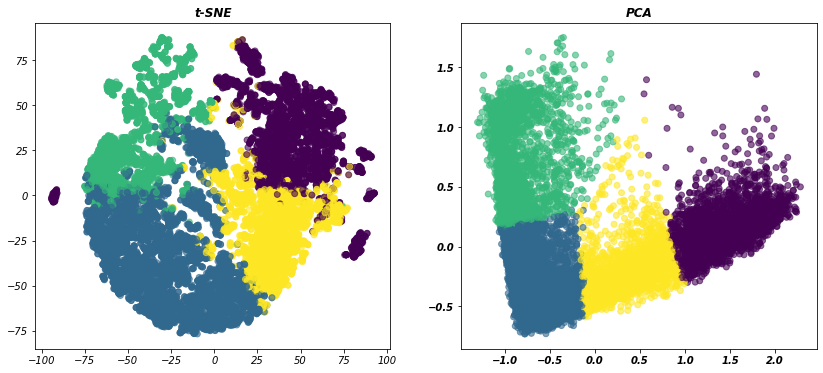

In [23]:
hp.plot_tsne_pca(X_reduced_tsne,X_reduced_pca,labels_km)

## K time-serie clusters graph 

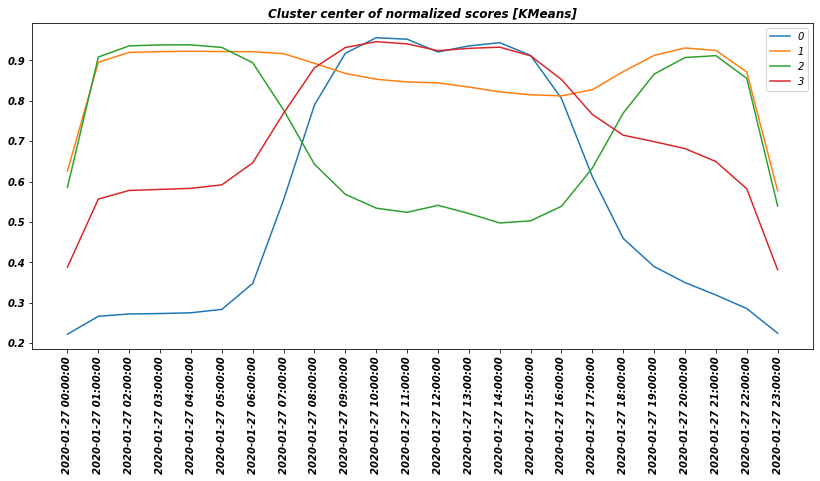

In [24]:
hp.plot_time_series_cluster(kmeans.cluster_centers_.T,"Cluster center of normalized scores [KMeans]",tiles_sample.columns)

------------------------------------------------------------------

## 3.3 Kmean Analysis with DTW 

https://tslearn.readthedocs.io/en/stable/gen_modules/clustering/tslearn.clustering.TimeSeriesKMeans.htm

In [25]:
#reshape as requested by the library https://tslearn.readthedocs.io/en/stable/gen_modules/clustering/tslearn.clustering.TimeSeriesKMeans.htm
ts_normalised_tslearn=ts_normalised.reshape(ts_normalised.shape[0],ts_normalised.shape[1],1)

In [26]:
ts_normalised_tslearn.shape

(15674, 24, 1)

In [27]:
# clustering
tsKmeans = TimeSeriesKMeans(n_clusters=k, metric="dtw",max_iter=500, random_state=42).fit(ts_normalised_tslearn)
labels_ts=tsKmeans.labels_



## Reducted dimension graph 

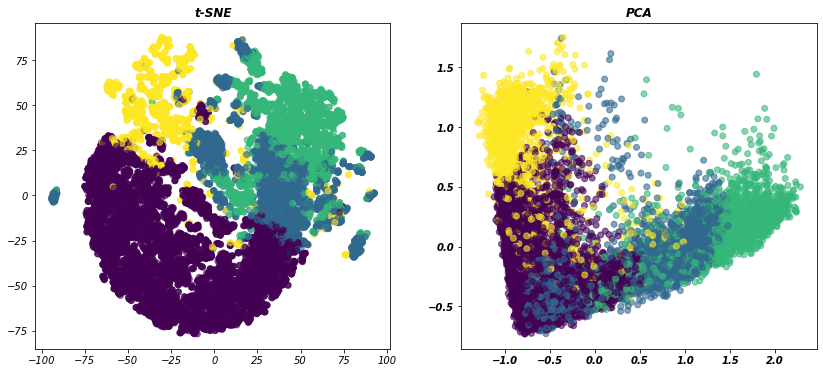

In [28]:
hp.plot_tsne_pca(X_reduced_tsne,X_reduced_pca,labels_ts)

## K time-serie clusters graph 

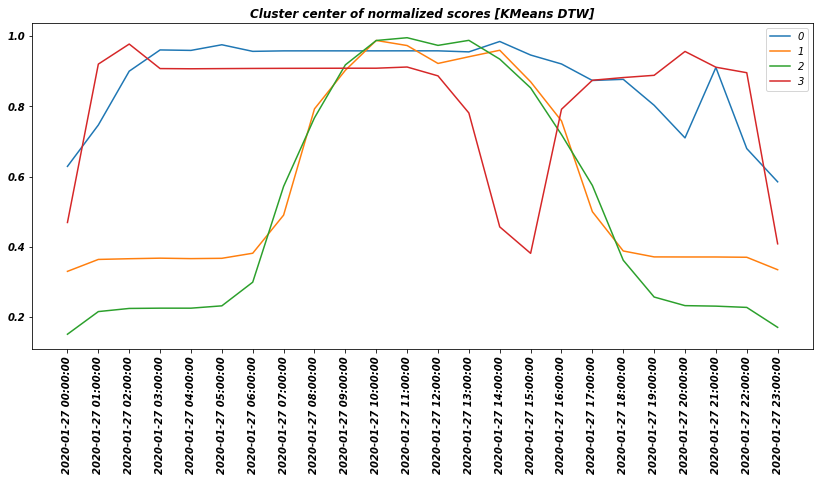

In [29]:
hp.plot_time_series_cluster(tsKmeans.cluster_centers_.T.reshape(24,k),"Cluster center of normalized scores [KMeans DTW]",tiles_sample.columns)

----------------------------------------------------------------------------------

## 3.4 DBSCAN


https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html

In [30]:
ts_normalised.shape

(15674, 24)

In [31]:
dbscan = DBSCAN(eps=0.5, min_samples=2).fit(ts_normalised)
labels_db=dbscan.labels_



## Reducted dimension graph 

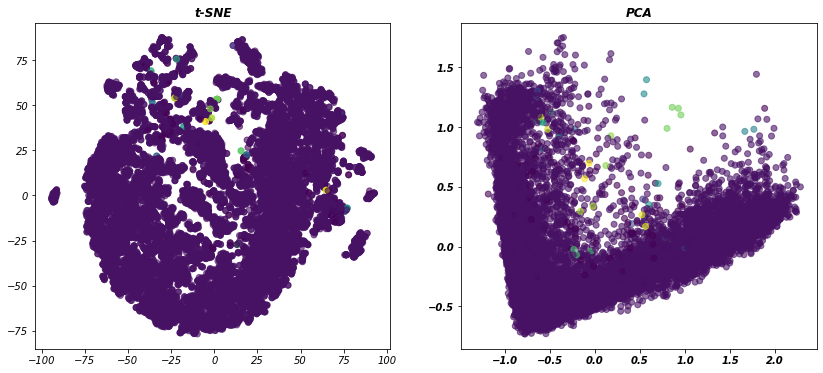

In [32]:
hp.plot_tsne_pca(X_reduced_tsne,X_reduced_pca,labels_db)

----------------------------------------------------------------------------------

## 3.5 KShape Analysis

https://tslearn.readthedocs.io/en/stable/gen_modules/clustering/tslearn.clustering.KShape.html#tslearn.clustering.KShape

In [33]:
#reshape as requested by the library https://tslearn.readthedocs.io/en/stable/gen_modules/clustering/tslearn.clustering.TimeSeriesKMeans.htm
ts_normalised_tslearn=ts_normalised.reshape(ts_normalised.shape[0],ts_normalised.shape[1],1)

In [34]:
ts_normalised_tslearn.shape

(15674, 24, 1)

In [35]:
# clustering
tsKShape = KShape(n_clusters=k, n_init=1, random_state=0).fit(ts_normalised_tslearn)
labels_KS=tsKShape.labels_


## Reducted dimension graph 

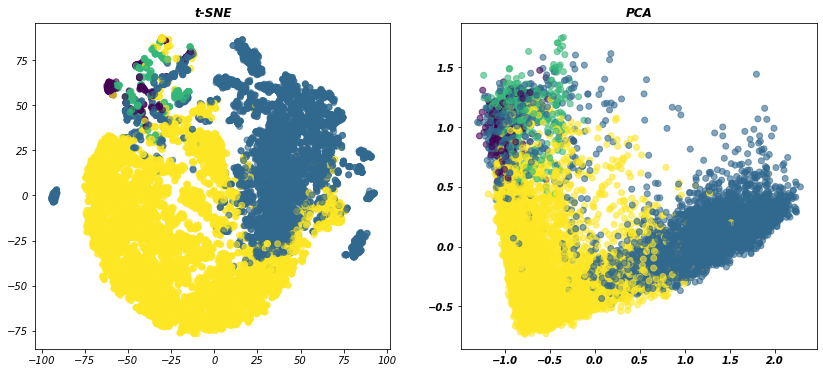

In [36]:
hp.plot_tsne_pca(X_reduced_tsne,X_reduced_pca,labels_KS)

## K time-serie clusters graph 

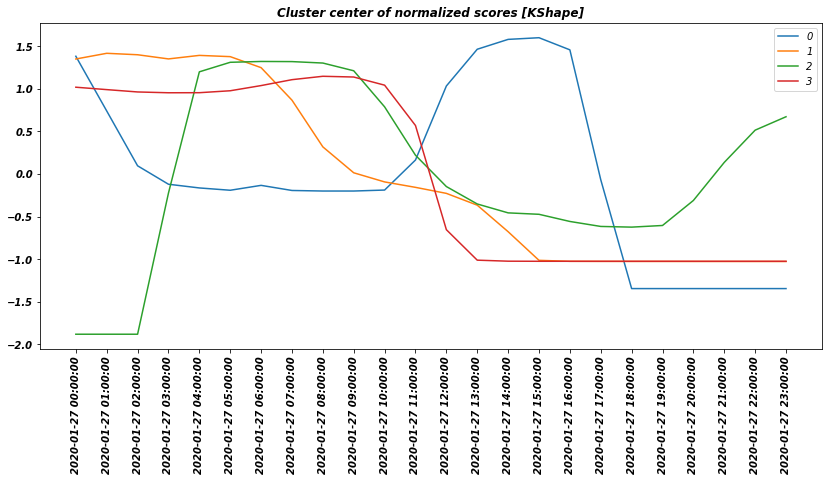

In [37]:
hp.plot_time_series_cluster(tsKShape.cluster_centers_.T.reshape(24,k),"Cluster center of normalized scores [KShape]",tiles_sample.columns)

--------------------------------------------------------------------------------------------------

# 4. Result


Finally, from the result of our analysis, Kmeans with euclidean distance and Kmeans with DTW looks to have a very close centroids. Moreover, the Kmeans with euclidean distance centroid looks reasonable as we can observe a group of tiles not active during the day (green). Those could correspond to the residential area. On the other hand, we observe a group of tiles more active during the day (blue and red). Those could be worker's areas. Finally, the  other cluster (yellow) is situated between the two extrema. Those result makes sense when we speak about cities as we have often two big zones ( business and residential center) and other parts of the city are a mix of habitation and workplace directed mostly to non-industrial jobs such as hairdresser, florist, etc.

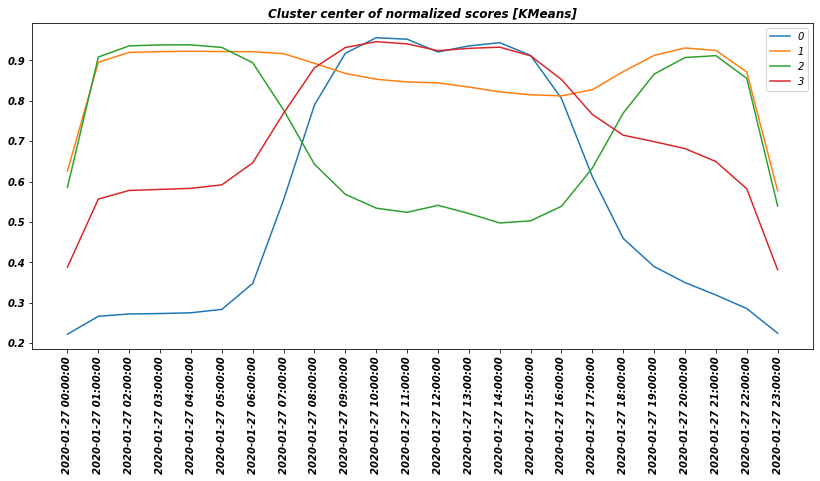

In [40]:
hp.plot_time_series_cluster(kmeans.cluster_centers_.T,"Cluster center of normalized scores [KMeans]",tiles_sample.columns)

In [41]:
score_cleaned["labels_tiles"]=labels_km

In [42]:
display(np.unique(score_cleaned.labels_tiles,return_counts=True))
config_tile_labeled=np.load('Data/tile_labeled.npy',allow_pickle='TRUE').item()
tile_labeled = keplergl.KeplerGl(height=500)
tile_labeled.add_data(data=score_cleaned ,name="Label Tiles")
tile_labeled.config = config_tile_labeled
tile_labeled

(array([0, 1, 2, 3]), array([3737, 6161, 2709, 3067], dtype=int64))

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'yul1gi8', 'type': …

In [43]:
# save configuration of the map to a pickle
np.save('Data/tile_labeled.npy',tile_labeled.config)

In [44]:
# save the data into a csv 
score_cleaned.to_csv("Data/heatmaps_city_sample_labeled.csv")

-------------------------------------------------------------------------------------------------------

### 